# Продвинутое глубокое обучение и обучение с подкреплением: ДЗ 3

Третье домашнее задание посвящено порождающим моделям, а точнее — порождающим состязательным сетям. Это самое маленькое и самое техническое задание в курсе, но что уж поделать. Как обычно, **в качестве решения ожидается ссылка на Jupyter-ноутбук на вашем GitHub (или публичный, или с доступом для *snikolenko*); ссылку обязательно нужно прислать в виде сданного домашнего задания на портале Академии**. Любые комментарии, новые идеи и рассуждения на тему, как всегда, категорически приветствуются.

# Импорт библиотек

In [1]:
import datetime
import itertools
import os
import random
import time
from pathlib import Path
from IPython.display import clear_output
from PIL import Image

import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as T
from torch.utils.data import Dataset, DataLoader
from torchvision.utils import make_grid, save_image

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"] = "3"

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [3]:
FIGSIZE = (16, 8)
FONTSIZE = 14

plt.rcParams["axes.titlesize"] = FONTSIZE
plt.rcParams["axes.labelsize"] = FONTSIZE

# Часть первая: перенос стиля при помощи pix2pix

В этом задании мы будем реализовывать перенос стиля на спаренных данных (paired data). Из стандартных датасетов я выбрал самый маленький — давайте реализуем перенос стиля из масок сегментации в “настоящие фотографии” для конкретного случая фасадов домов:

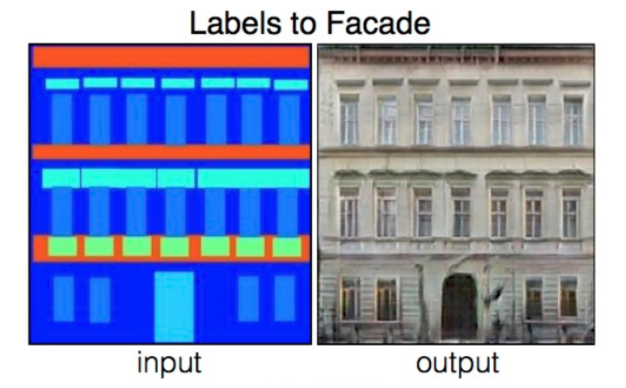

Датасет можно скачать [здесь](http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz) (и во многих других местах, должно быть ~29 мегабайт).

В первой части подразумевается реализация pix2pix архитектуры, то есть генератора и дискриминатора, которые получают на вход условие в виде изображения исходного стиля (подробнее см. лекцию и собственно [Isola et al., 2016](https://arxiv.org/pdf/1611.07004.pdf)):

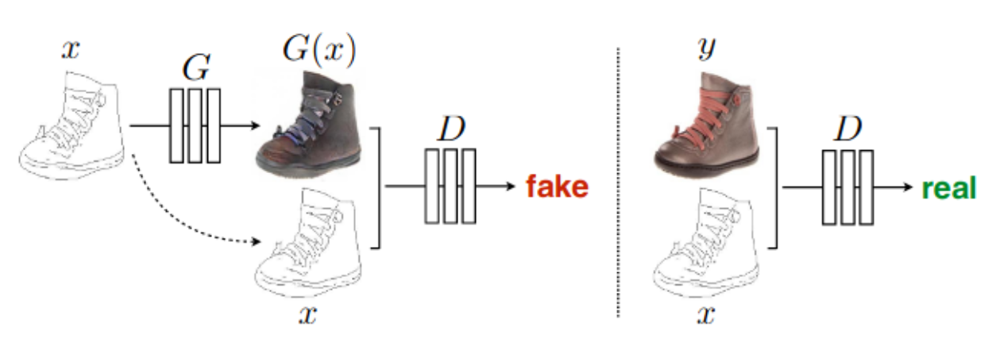

## Загрузка данных

In [4]:
%%bash

ARCHIVE_PATH=data.tar.gz
DATA_PATH=facades

if [ ! -d $DATA_PATH ]; then
    wget -q -O $ARCHIVE_PATH http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz

    tar -xzf $ARCHIVE_PATH
    rm $ARCHIVE_PATH
fi

## Классы датасета и моделей

In [5]:
class ImageDataset(Dataset):
    def __init__(self, root, transforms=None, paired: bool = True, mode: str = "train"):
        self.transform = T.Compose(transforms)
        self.paired = paired

        self.files = sorted((Path(root) / mode).rglob("*.jpg"))
        if mode == "train":
            self.files.extend(sorted((Path(root) / "test").rglob("*.jpg")))

    def __getitem__(self, index):
        img = Image.open(self.files[index % len(self.files)])
        w, h = img.size
        real_input = img.crop((w / 2, 0, w, h))

        if not self.paired:
            img = Image.open(np.random.choice(self.files))
            w, h = img.size

        real_output = img.crop((0, 0, w / 2, h))

        real_input = self.transform(real_input)
        real_output = self.transform(real_output)

        return {"input": real_input, "output": real_output}

    def __len__(self):
        return len(self.files)

In [6]:
def weights_init_normal(module: nn.Module) -> None:
    classname = module.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(module.weight.data, 0.0, 0.02)
        if hasattr(module, "bias") and module.bias is not None:
            nn.init.constant_(module.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        nn.init.normal_(module.weight.data, 1.0, 0.02)
        nn.init.constant_(module.bias.data, 0.0)


class UNetDownBlock(nn.Module):
    def __init__(self, in_size, out_size,
                 normalize: bool = True, dropout: float = 0.0):
        super().__init__()

        layers = [nn.Conv2d(in_size, out_size, kernel_size=4, stride=2, padding=1, bias=False)]
        if normalize:
            layers.append(nn.InstanceNorm2d(out_size))
        layers.append(nn.LeakyReLU(negative_slope=0.2, inplace=True))
        if dropout:
            layers.append(nn.Dropout(dropout))

        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


class UNetUpBlock(nn.Module):
    def __init__(self, in_size, out_size, dropout: float = 0.0):
        super().__init__()

        layers = [
            nn.ConvTranspose2d(in_size, out_size, kernel_size=4, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(out_size),
            nn.ReLU(inplace=True),
        ]
        if dropout:
            layers.append(nn.Dropout(dropout))

        self.model = nn.Sequential(*layers)

    def forward(self, x, skip_input):
        x = self.model(x)
        x = torch.cat((x, skip_input), dim=1)

        return x


class GeneratorUNet(nn.Module):
    def __init__(self, in_channels: int = 3, out_channels: int = 3):
        super().__init__()

        self.down_1 = UNetDownBlock(in_size=in_channels, out_size=64, normalize=False)
        self.down_2 = UNetDownBlock(in_size=64, out_size=128)
        self.down_3 = UNetDownBlock(in_size=128, out_size=256)
        self.down_4 = UNetDownBlock(in_size=256, out_size=512, dropout=0.5)
        self.down_5 = UNetDownBlock(in_size=512, out_size=512, dropout=0.5)
        self.down_6 = UNetDownBlock(in_size=512, out_size=512, dropout=0.5)
        self.down_7 = UNetDownBlock(in_size=512, out_size=512, dropout=0.5)
        self.down_8 = UNetDownBlock(in_size=512, out_size=512, normalize=False, dropout=0.5)

        self.up_1 = UNetUpBlock(in_size=512, out_size=512, dropout=0.5)
        self.up_2 = UNetUpBlock(in_size=1024, out_size=512, dropout=0.5)
        self.up_3 = UNetUpBlock(in_size=1024, out_size=512, dropout=0.5)
        self.up_4 = UNetUpBlock(in_size=1024, out_size=512, dropout=0.5)
        self.up_5 = UNetUpBlock(in_size=1024, out_size=256)
        self.up_6 = UNetUpBlock(in_size=512, out_size=128)
        self.up_7 = UNetUpBlock(in_size=256, out_size=64)

        self.final = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.ZeroPad2d(padding=(1, 0, 1, 0)),
            nn.Conv2d(128, out_channels, kernel_size=4, padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        # U-Net generator with skip connections from encoder to decoder
        d_1 = self.down_1(x)
        d_2 = self.down_2(d_1)
        d_3 = self.down_3(d_2)
        d_4 = self.down_4(d_3)
        d_5 = self.down_5(d_4)
        d_6 = self.down_6(d_5)
        d_7 = self.down_7(d_6)
        d_8 = self.down_8(d_7)
        u_1 = self.up_1(d_8, d_7)
        u_2 = self.up_2(u_1, d_6)
        u_3 = self.up_3(u_2, d_5)
        u_4 = self.up_4(u_3, d_4)
        u_5 = self.up_5(u_4, d_3)
        u_6 = self.up_6(u_5, d_2)
        u_7 = self.up_7(u_6, d_1)

        return self.final(u_7)


class Discriminator(nn.Module):
    def __init__(self, in_channels: int = 3):
        super().__init__()

        def discriminator_block(in_filters, out_filters, normalize: bool = True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, kernel_size=4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(negative_slope=0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(in_channels * 2, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d(padding=(1, 0, 1, 0)),
            nn.Conv2d(512, 1, kernel_size=4, padding=1, bias=False)
        )

    def forward(self, img, img_cond):
        # Concatenate image and condition image by channels to produce input
        img_input = torch.cat((img, img_cond), dim=1)
        return self.model(img_input)

## Параметры обучения

In [7]:
# training parameters
DATASET_NAME = "facades"  # name of the dataset
EPOCH = 0  # epoch to start training from
NUM_EPOCHS = 200  # number of epochs of training
BATCH_SIZE = 1  # batch size for training
VALID_BATCH_SIZE = 10  # # batch size for validation
NUM_CPU_THREADS = 8  # number of cpu threads to use during batch generation
SAMPLE_INTERVAL = 1  # number of epochs between generator(s) testing
CHECKPOINT_INTERVAL = 200  # number of epochs between model checkpoints

# optimizer parameters
LEARNING_RATE = 2e-4  # Adam: learning rate
BETA_1 = 0.5  # Adam: decay of first order momentum of gradient
BETA_2 = 0.999  # Adam: decay of first order momentum of gradient
DECAY_EPOCH = 100  # epoch from which to start lr decay

# image sizes
IMG_HEIGHT = 256  # size of image height
IMG_WIDTH = 256  # size of image width
IMG_CHANNELS = 3  # number of image channels
PATCH_SIZE = (1, IMG_HEIGHT // 2 ** 4, IMG_WIDTH // 2 ** 4)  # output shape of image discriminator (PatchGAN)

In [8]:
DATASET_PATH = Path(f"{DATASET_NAME}")
SAMPLED_IMAGES_PATH = Path(f"{DATASET_NAME}/sampled_images")
SAVED_MODELS_PATH = Path(f"{DATASET_NAME}/saved_models")

SAMPLED_IMAGES_PATH.mkdir(parents=True, exist_ok=True)
SAVED_MODELS_PATH.mkdir(parents=True, exist_ok=True)

## Преобразования

In [9]:
# image transformations
transforms = [
    T.Resize((IMG_HEIGHT, IMG_WIDTH), T.InterpolationMode.BICUBIC),
    T.ToTensor(),
    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
]

## DataLoaders

In [10]:
train_dataloader = DataLoader(
    ImageDataset(DATASET_PATH, transforms=transforms, mode="train"),
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_CPU_THREADS
)

In [11]:
val_dataloader = DataLoader(
    ImageDataset(DATASET_PATH, transforms=transforms, mode="val"),
    batch_size=VALID_BATCH_SIZE,
    shuffle=False,
    num_workers=1
)

## Модели

In [12]:
# models
generator = GeneratorUNet().to(device)
discriminator = Discriminator().to(device)

In [13]:
if EPOCH != 0:
    # load pretrained models
    generator.load_state_dict(
        torch.load(f"{SAVED_MODELS_PATH}/generator_{EPOCH}.pth")
    )
    discriminator.load_state_dict(
        torch.load(f"{SAVED_MODELS_PATH}/discriminator_{EPOCH}.pth")
    )
else:
    # initialize weights
    generator.apply(weights_init_normal)
    discriminator.apply(weights_init_normal)

In [14]:
# loss functions
criterion_gan = nn.MSELoss().to(device)
criterion_pixelwise = nn.L1Loss().to(device)

# loss weight of L1 pixel-wise loss between generated and real images
LAMBDA_PIXEL = 100

In [15]:
# optimizers
optimizer_g = optim.Adam(
    generator.parameters(), lr=LEARNING_RATE, betas=(BETA_1, BETA_2)
)
optimizer_d = optim.Adam(
    discriminator.parameters(), lr=LEARNING_RATE, betas=(BETA_1, BETA_2)
)

## Обучение

In [16]:
def sample_images(generator, val_dataloader, epoch: int, device: torch.device):
    """Saves a generated sample from the validation set"""
    imgs = next(iter(val_dataloader))

    with torch.no_grad():
        generator.eval()

        real_input = imgs["input"].cpu()
        real_output = imgs["output"].cpu()

        fake_output = generator(real_input.to(device)).cpu()

    img_sample = torch.cat((real_input, fake_output, real_output), dim=-2)

    save_image(
        img_sample,
        f"{SAMPLED_IMAGES_PATH}/{epoch}.png",
        nrow=5,
        normalize=True
    )

In [17]:
def train(
    generator, discriminator,
    train_dataloader, val_dataloader,
    criterion_gan, criterion_pixelwise, lambda_pixel,
    optimizer_g, optimizer_d,
    start_epoch: int, num_epochs: int,
    sample_every: int, save_every: int,
    device: torch.device
):
    start_time = time.time()
    batches_done, batches_left = 0, num_epochs * len(train_dataloader)

    history_loss_d = []
    history_loss_g = []
    history_loss_pixel = []
    history_loss_gan = []

    window_loss_d, window_loss_g, window_loss_pixel, window_loss_gan = [], [], [], []

    for epoch in range(start_epoch, num_epochs):
        for i, batch in enumerate(train_dataloader):
            batch_size = batch["input"].shape[0]

            # model inputs
            real_input = batch["input"].to(device)
            real_output = batch["output"].to(device)

            # adversarial ground truths
            real_ground_truth = torch.ones(
                (batch_size, *PATCH_SIZE),
                dtype=torch.float,
                requires_grad=False,
                device=device
            )
            fake_ground_truth = torch.zeros(
                (batch_size, *PATCH_SIZE),
                dtype=torch.float,
                requires_grad=False,
                device=device
            )

            # GENERATOR

            generator.train()

            optimizer_g.zero_grad()

            # generate image from real input image
            fake_output = generator(real_input)
            # discriminator tells if generated image is real conditioned on real input image
            fake_pred = discriminator(fake_output, real_input)
            # PatchGAN loss
            loss_gan = criterion_gan(fake_pred, real_ground_truth)
            # pixelwise loss
            loss_pixel = criterion_pixelwise(fake_output, real_output)

            # total generator loss
            loss_g = loss_gan + lambda_pixel * loss_pixel

            # backpropagation
            loss_g.backward()
            optimizer_g.step()

            # DISCRIMINATOR

            optimizer_d.zero_grad()

            # loss for real image classification
            # discriminator tells if real image is real conditioned on real input image
            real_pred = discriminator(real_output, real_input)
            loss_d_real = criterion_gan(real_pred, real_ground_truth)

            # loss for fake image classification
            fake_pred = discriminator(fake_output.detach(), real_input)
            loss_d_fake = criterion_gan(fake_pred, fake_ground_truth)

            # total discriminator loss
            # (divide the objective by 2 while optimizing D,
            # which slows down the rate at which D learns relative to G)
            loss_d = (loss_d_real + loss_d_fake) / 2

            # backpropagation
            loss_d.backward()
            optimizer_d.step()

            # LOG PROGRESS

            # determine approximate time left
            batches_done += batch_size
            batches_left -= batch_size
            time_left = datetime.timedelta(seconds=(time.time() - start_time) / batches_done * batches_left)

            # print log
            print(
                f"\r[Epoch {epoch:03}/{num_epochs}] "
                f"[Batch {i:03}/{len(train_dataloader)}] "
                f"[D loss: {loss_d.item():.6f}] "
                f"[G loss: {loss_g.item():.6f}, L1: {loss_pixel.item():.6f}, "
                f"MSE: {loss_gan.item():.6f}] "
                f"ETA: {time_left}",
                end=""
            )

            window_loss_d.append(loss_d.item())
            window_loss_g.append(loss_g.item())
            window_loss_pixel.append(loss_pixel.item())
            window_loss_gan.append(loss_gan.item())

        # save images
        if epoch % sample_every == 0:
            sample_images(generator, val_dataloader, epoch, device)

            history_loss_d.append(np.mean(window_loss_d))
            window_loss_d = []

            history_loss_g.append(np.mean(window_loss_g))
            window_loss_g = []

            history_loss_pixel.append(np.mean(window_loss_pixel))
            window_loss_pixel = []

            history_loss_gan.append(np.mean(window_loss_gan))
            window_loss_gan = []

            _, axes = plt.subplots(1, 4, figsize=FIGSIZE)

            axes[0].set_title("Discriminator Loss")
            axes[0].plot(history_loss_d)
            axes[0].grid()

            axes[1].set_title("Generator Loss")
            axes[1].plot(history_loss_g)
            axes[1].grid()

            axes[2].set_title("Pixelwise (L1) Loss")
            axes[2].plot(history_loss_pixel)
            axes[2].grid()

            axes[3].set_title("Adversarial (MSE) Loss")
            axes[3].plot(history_loss_gan)
            axes[3].grid()

            clear_output()
            plt.show()

        if save_every is not None and epoch % save_every == 0:
            # save model checkpoints
            torch.save(
                generator.state_dict(),
                f"{SAVED_MODELS_PATH}/generator_{epoch}.pth"
            )
            torch.save(
                discriminator.state_dict(),
                f"{SAVED_MODELS_PATH}/discriminator_{epoch}.pth"
            )

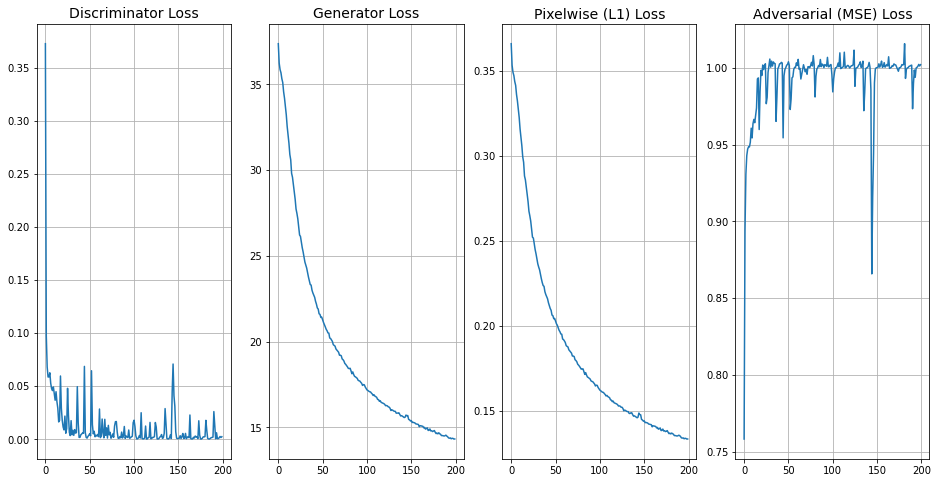

In [18]:
train(
    generator, discriminator,
    train_dataloader, val_dataloader,
    criterion_gan, criterion_pixelwise, LAMBDA_PIXEL,
    optimizer_g, optimizer_d,
    start_epoch=EPOCH, num_epochs=NUM_EPOCHS,
    sample_every=SAMPLE_INTERVAL, save_every=CHECKPOINT_INTERVAL,
    device=device
)

In [19]:
torch.cuda.empty_cache()

Результаты после 1 эпохи:

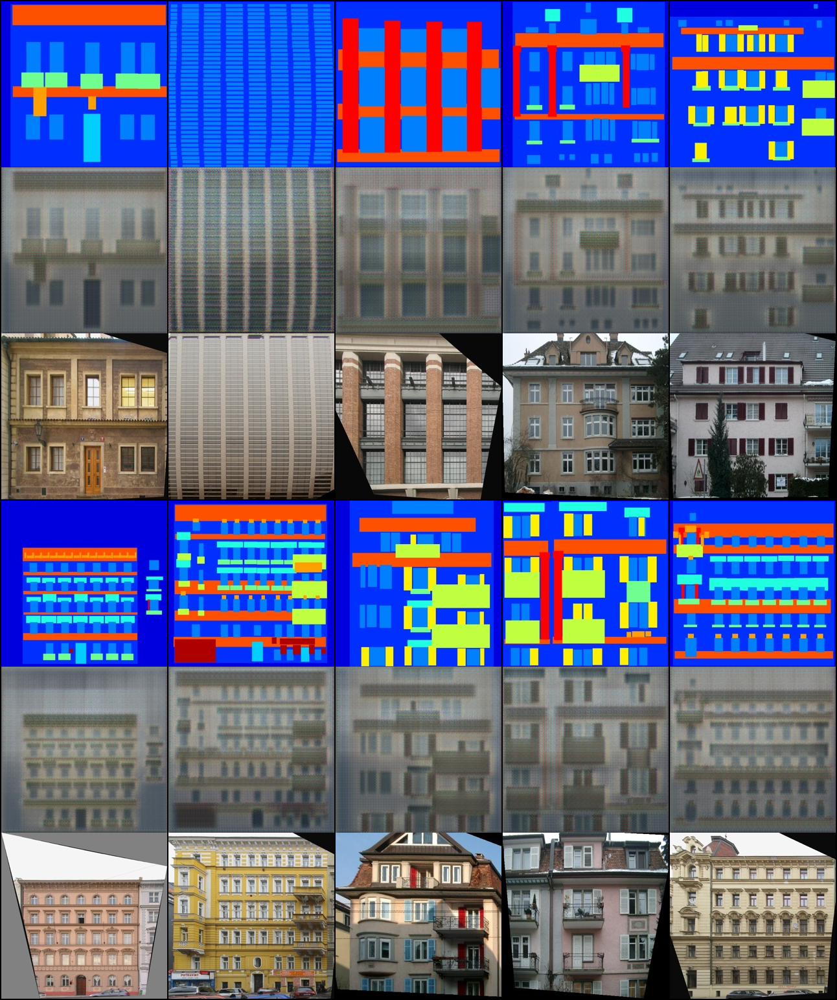

In [20]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '0.png'}"))

Результаты после 50 эпох:

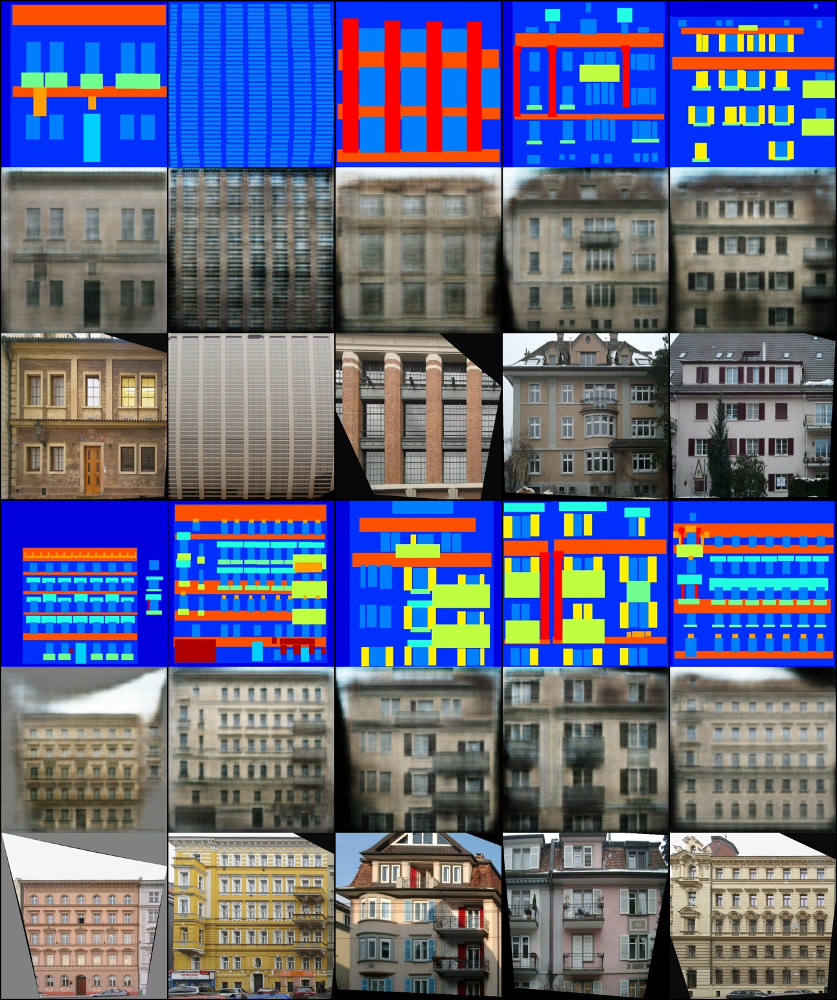

In [21]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '49.png'}"))

Результаты после 100 эпох:

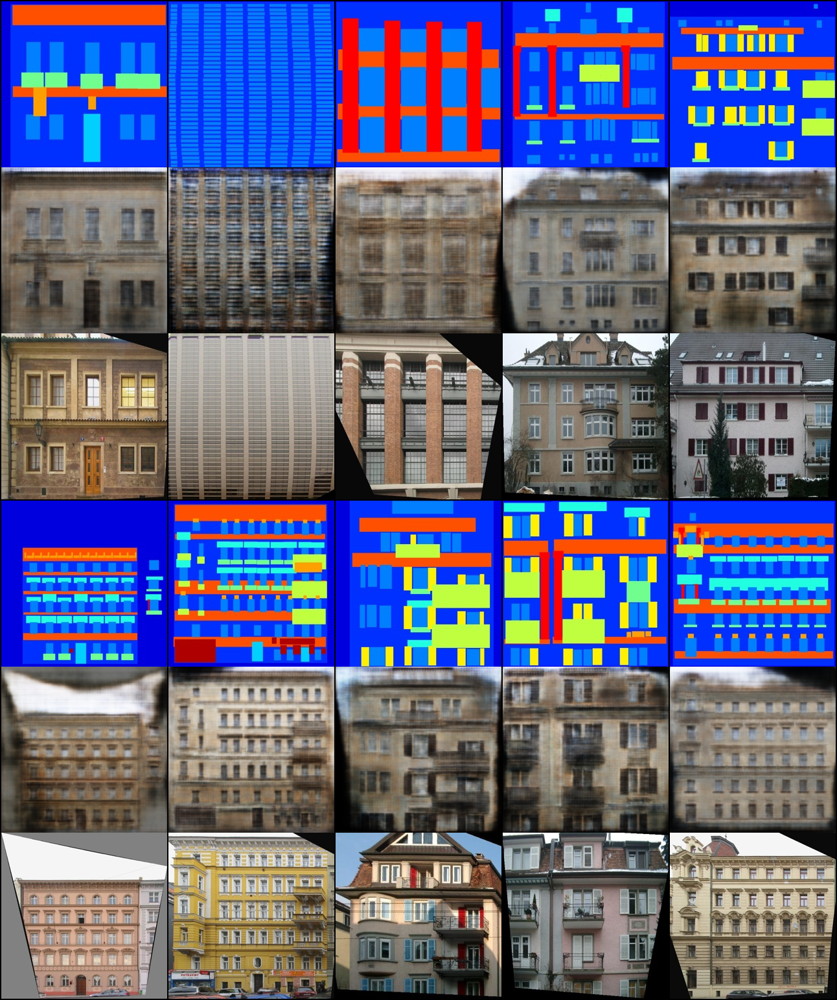

In [22]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '99.png'}"))

Результаты после 150 эпох:

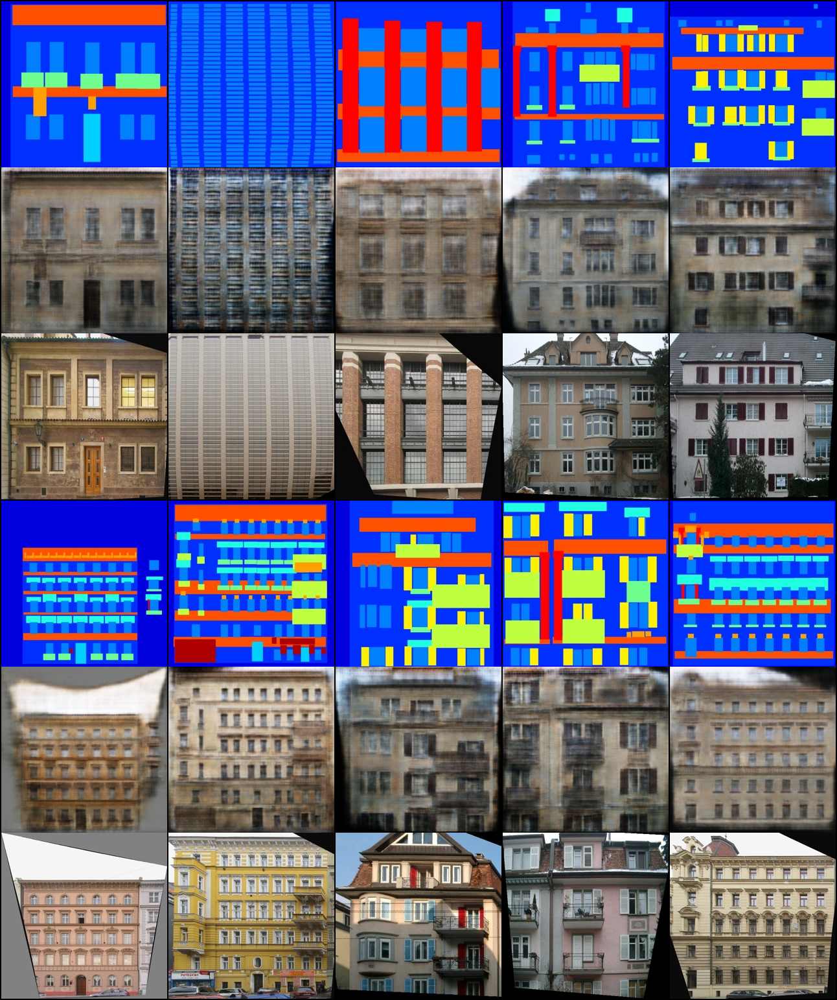

In [23]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '149.png'}"))

Результаты после 200 эпох:

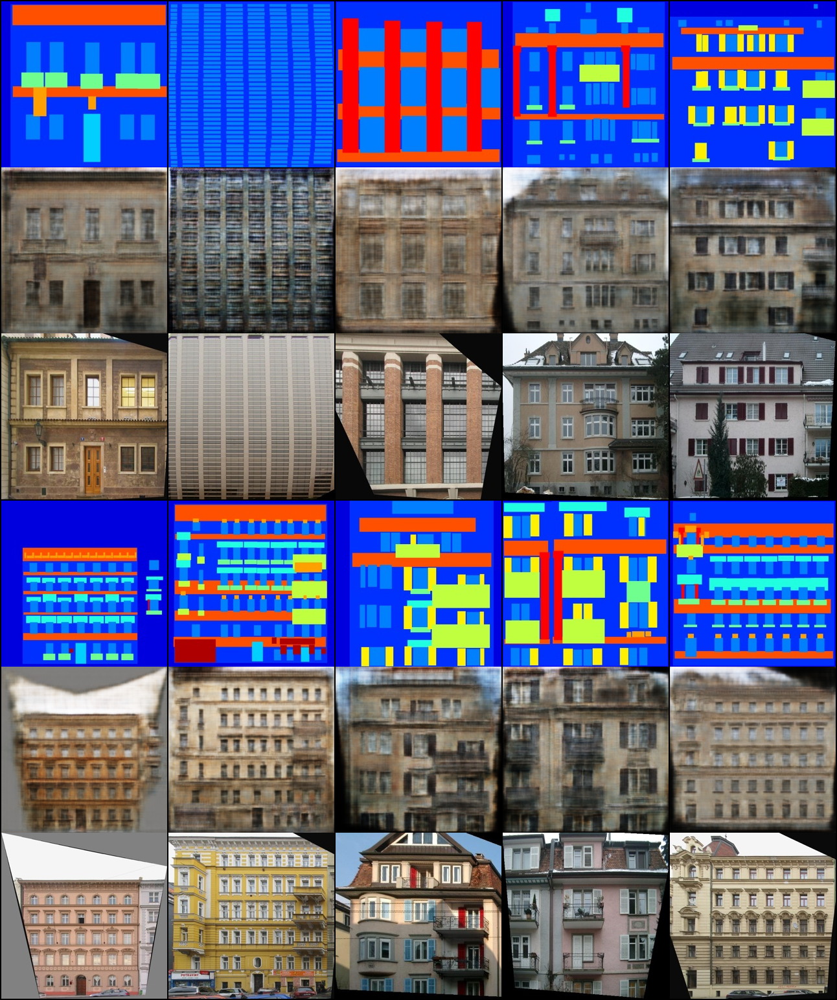

In [24]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '199.png'}"))

# Часть вторая: добавим циклы

Вторая часть — реализация CycleGAN. Предлагается на том же датасете реализовать базовую конструкцию CycleGAN для unpaired style transfer, то есть переноса стилей, каждый из которых задан неразмеченным датасетом (подробнее см. лекцию и собственно [Zhu et al., 2017](https://arxiv.org/pdf/1703.10593.pdf)):

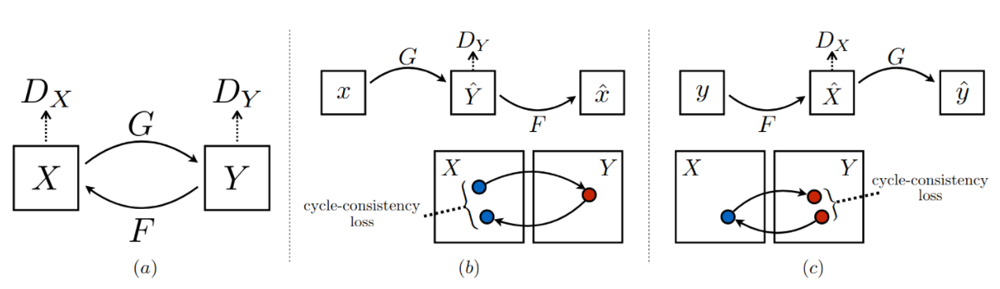

В качестве опционального задания за немного дополнительных баллов здесь предлагаю найти дополнительные данные такого рода (фасады и их карты сегментации) и улучшить качество переноса стиля за счёт обучения на датасете побольше. Данные, скорее всего, будут unpaired, поэтому эта часть скорее релевантна CycleGAN.

## Классы моделей

In [25]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super().__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(padding=1),
            nn.Conv2d(in_features, in_features, kernel_size=3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(padding=1),
            nn.Conv2d(in_features, in_features, kernel_size=3),
            nn.InstanceNorm2d(in_features),
        )

    def forward(self, x):
        return x + self.block(x)


class GeneratorResNet(nn.Module):
    def __init__(self, in_channels: int = 3, num_residual_blocks: int = 9):
        super().__init__()

        # initial convolution block
        out_features = 64
        model = [
            nn.ReflectionPad2d(padding=in_channels),
            nn.Conv2d(in_channels, out_features, kernel_size=7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features

        # downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, kernel_size=3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]

        # upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, kernel_size=3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # output layer
        model += [
            nn.ReflectionPad2d(padding=in_channels),
            nn.Conv2d(out_features, in_channels, kernel_size=7),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

In [26]:
class Discriminator(nn.Module):
    def __init__(self, in_channels: int = 3):
        super().__init__()

        def discriminator_block(in_filters, out_filters, normalize: bool = True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, kernel_size=4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(negative_slope=0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(in_channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d(padding=(1, 0, 1, 0)),
            nn.Conv2d(512, 1, kernel_size=4, padding=1)
        )

    def forward(self, x):
        return self.model(x)

## DataLoaders

In [27]:
train_dataloader = DataLoader(
    ImageDataset(DATASET_PATH, transforms=transforms, paired=False, mode="train"),
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_CPU_THREADS
)

In [28]:
val_dataloader = DataLoader(
    ImageDataset(DATASET_PATH, transforms=transforms, paired=False, mode="val"),
    batch_size=VALID_BATCH_SIZE,
    shuffle=False,
    num_workers=1
)

## Модели

In [29]:
# models
generator_a = GeneratorResNet(IMG_CHANNELS, num_residual_blocks=9).to(device)
generator_b = GeneratorResNet(IMG_CHANNELS, num_residual_blocks=9).to(device)
discriminator_a = Discriminator().to(device)
discriminator_b = Discriminator().to(device)

In [30]:
if EPOCH != 0:
    # load pretrained models
    generator_a.load_state_dict(
        torch.load(f"{SAVED_MODELS_PATH}/generator_a_{EPOCH}.pth")
    )
    generator_b.load_state_dict(
        torch.load(f"{SAVED_MODELS_PATH}/generator_b_{EPOCH}.pth")
    )
    discriminator_a.load_state_dict(
        torch.load(f"{SAVED_MODELS_PATH}/discriminator_a_{EPOCH}.pth")
    )
    discriminator_b.load_state_dict(
        torch.load(f"{SAVED_MODELS_PATH}/discriminator_b_{EPOCH}.pth")
    )
else:
    # initialize weights
    generator_a.apply(weights_init_normal)
    generator_b.apply(weights_init_normal)
    discriminator_a.apply(weights_init_normal)
    discriminator_b.apply(weights_init_normal)

In [31]:
# loss functions
criterion_gan = nn.MSELoss().to(device)
criterion_cycle = nn.L1Loss().to(device)
criterion_identity = nn.L1Loss().to(device)

# loss weights
LAMBDA_CYCLE = 10.0
LAMBDA_IDENTITY = 5.0

In [32]:
# optimizers
optimizer_g = optim.Adam(
    itertools.chain(
        generator_a.parameters(),
        generator_b.parameters()
    ),
    lr=LEARNING_RATE,
    betas=(BETA_1, BETA_2)
)
optimizer_d_a = torch.optim.Adam(
    discriminator_a.parameters(),
    lr=LEARNING_RATE,
    betas=(BETA_1, BETA_2)
)
optimizer_d_b = torch.optim.Adam(
    discriminator_b.parameters(),
    lr=LEARNING_RATE,
    betas=(BETA_1, BETA_2)
)

In [33]:
class LambdaLR:
    def __init__(self, n_epochs, offset, decay_start_epoch):
        assert n_epochs - decay_start_epoch > 0, (
            "Decay must start before the training session ends!"
        )
        self.n_epochs = n_epochs
        self.offset = offset
        self.decay_start_epoch = decay_start_epoch

    def step(self, epoch):
        return 1.0 - max(0, epoch + self.offset - self.decay_start_epoch) \
                     / (self.n_epochs - self.decay_start_epoch)

In [34]:
# schedulers
lr_scheduler_g = optim.lr_scheduler.LambdaLR(
    optimizer_g,
    lr_lambda=LambdaLR(NUM_EPOCHS, EPOCH, DECAY_EPOCH).step
)
lr_scheduler_d_a = optim.lr_scheduler.LambdaLR(
    optimizer_d_a,
    lr_lambda=LambdaLR(NUM_EPOCHS, EPOCH, DECAY_EPOCH).step
)
lr_scheduler_d_b = torch.optim.lr_scheduler.LambdaLR(
    optimizer_d_b,
    lr_lambda=LambdaLR(NUM_EPOCHS, EPOCH, DECAY_EPOCH).step
)

In [35]:
class ReplayBuffer:
    def __init__(self, max_size: int = 50):
        assert max_size > 0, (
            "Empty buffer or trying to create a black hole. Be careful."
        )
        self.max_size = max_size
        self.data = []

    def push_and_pop(self, data):
        to_return = []
        for element in data.data:
            element = torch.unsqueeze(element, 0)
            if len(self.data) < self.max_size:
                self.data.append(element)
                to_return.append(element)
            else:
                if random.uniform(0, 1) > 0.5:
                    i = random.randint(0, self.max_size - 1)
                    to_return.append(self.data[i].clone())
                    self.data[i] = element
                else:
                    to_return.append(element)
        result = torch.cat(to_return)
        result.requires_grad = True
        return result

In [36]:
# buffers of previously generated samples
buffer_a = ReplayBuffer()
buffer_b = ReplayBuffer()

## Обучение

In [37]:
def sample_images(generator_a, generator_b, val_dataloader, epoch: int, device: torch.device):
    """Saves a generated sample from the validation set"""
    imgs = next(iter(val_dataloader))

    with torch.no_grad():
        generator_a.eval()
        generator_b.eval()

        real_input = imgs["input"].cpu()
        real_output = imgs["output"].cpu()

        fake_output = generator_a(real_input.to(device)).cpu()
        fake_input = generator_b(real_output.to(device)).cpu()

    # arange images along x-axis
    real_input_grid = make_grid(real_input, nrow=5, normalize=True)
    real_output_grid = make_grid(real_output, nrow=5, normalize=True)
    fake_input_grid = make_grid(fake_input, nrow=5, normalize=True)
    fake_output_grid = make_grid(fake_output, nrow=5, normalize=True)

    # arange grids along y-axis
    full_grid = torch.cat(
        (real_input_grid, real_output_grid, fake_output_grid, fake_input_grid),
        dim=1
    )

    save_image(
        full_grid,
        f"{SAMPLED_IMAGES_PATH}/{epoch}.png",
        normalize=False
    )

In [38]:
def train(
    generator_a, generator_b,
    discriminator_a, discriminator_b,
    train_dataloader, val_dataloader,
    criterion_gan, criterion_cycle, criterion_identity,
    lambda_cycle, lambda_identity,
    optimizer_g, optimizer_d_a, optimizer_d_b,
    lr_scheduler_g, lr_scheduler_d_a, lr_scheduler_d_b,
    buffer_a, buffer_b,
    start_epoch: int, num_epochs: int,
    sample_every: int, save_every: int,
    device: torch.device
):
    start_time = time.time()
    batches_done, batches_left = 0, num_epochs * len(train_dataloader)

    history_loss_d = []
    history_loss_g = []
    history_loss_identity = []
    history_loss_cycle = []
    history_loss_gan = []

    window_loss_d, window_loss_g, window_loss_identity, window_loss_cycle, window_loss_gan = [], [], [], [], []

    for epoch in range(start_epoch, num_epochs):
        for i, batch in enumerate(train_dataloader):
            batch_size = batch["input"].shape[0]

            # model inputs
            real_input = batch["input"].to(device)
            real_output = batch["output"].to(device)

            # adversarial ground truths
            real_ground_truth = torch.ones(
                (batch_size, *PATCH_SIZE),
                dtype=torch.float,
                requires_grad=False,
                device=device
            )
            fake_ground_truth = torch.zeros(
                (batch_size, *PATCH_SIZE),
                dtype=torch.float,
                requires_grad=False,
                device=device
            )

            #  GENERATORS

            generator_a.train()
            generator_b.train()

            optimizer_g.zero_grad()

            # identity loss
            loss_id_a = criterion_identity(generator_b(real_input), real_input)
            loss_id_b = criterion_identity(generator_a(real_output), real_output)

            loss_identity = (loss_id_a + loss_id_b) / 2

            # GAN loss
            fake_output_b = generator_a(real_input)
            loss_gan_a = criterion_gan(discriminator_b(fake_output_b), real_ground_truth)
            fake_input_a = generator_b(real_output)
            loss_gan_b = criterion_gan(discriminator_a(fake_input_a), real_ground_truth)

            loss_gan = (loss_gan_a + loss_gan_b) / 2

            # forward/backward cycle-consistency loss
            recov_a = generator_b(fake_output_b)
            loss_cycle_a = criterion_cycle(recov_a, real_input)
            recov_b = generator_a(fake_input_a)
            loss_cycle_b = criterion_cycle(recov_b, real_output)

            loss_cycle = (loss_cycle_a + loss_cycle_b) / 2

            # total generator loss
            loss_g = loss_gan + lambda_cycle * loss_cycle + lambda_identity * loss_identity

            loss_g.backward()
            optimizer_g.step()

            # DISCRIMINATOR A

            optimizer_d_a.zero_grad()

            # real loss
            loss_real = criterion_gan(discriminator_a(real_input), real_ground_truth)
            # fake loss (on batch of previously generated samples)
            fake_history_a = buffer_a.push_and_pop(fake_input_a)
            loss_fake = criterion_gan(discriminator_a(fake_history_a.detach()), fake_ground_truth)
            # total discriminator_a loss
            loss_d_a = (loss_real + loss_fake) / 2

            loss_d_a.backward()
            optimizer_d_a.step()

            # DISCRIMINATOR B

            optimizer_d_b.zero_grad()

            # real loss
            loss_real = criterion_gan(discriminator_b(real_output), real_ground_truth)
            # fake loss (on batch of previously generated samples)
            fake_history_b = buffer_b.push_and_pop(fake_output_b)
            loss_fake = criterion_gan(discriminator_b(fake_history_b.detach()), fake_ground_truth)
            # total discriminator_b loss
            loss_d_b = (loss_real + loss_fake) / 2

            loss_d_b.backward()
            optimizer_d_b.step()

            # total discriminators loss (just to log it)
            loss_d = (loss_d_a + loss_d_b) / 2

            # LOG PROGRESS

            # Determine approximate time left
            batches_done += batch_size
            batches_left -= batch_size
            time_left = datetime.timedelta(seconds=(time.time() - start_time) / batches_done * batches_left)

            # Print log
            print(
                f"\r[Epoch {epoch:03}/{num_epochs}] "
                f"[Batch {i:03}/{len(train_dataloader)}] "
                f"[D loss: {loss_d.item():.6f}] "
                f"[G loss: {loss_g.item():.6f}, cycle: {loss_cycle.item():.6f}, "
                f"identity: {loss_identity.item():.6f}] "
                f"ETA: {time_left}",
                end=""
            )

            window_loss_d.append(loss_d.item())
            window_loss_g.append(loss_g.item())
            window_loss_cycle.append(loss_cycle.item())
            window_loss_identity.append(loss_identity.item())
            window_loss_gan.append(loss_gan.item())

        # update learning rates
        lr_scheduler_g.step()
        lr_scheduler_d_a.step()
        lr_scheduler_d_b.step()

        # save images
        if epoch % sample_every == 0:
            sample_images(generator_a, generator_b, val_dataloader, epoch, device)

            history_loss_d.append(np.mean(window_loss_d))
            window_loss_d = []

            history_loss_g.append(np.mean(window_loss_g))
            window_loss_g = []

            history_loss_cycle.append(np.mean(window_loss_cycle))
            window_loss_cycle = []

            history_loss_identity.append(np.mean(window_loss_identity))
            window_loss_identity = []

            history_loss_gan.append(np.mean(window_loss_gan))
            window_loss_gan = []

            _, axes = plt.subplots(1, 5, figsize=FIGSIZE)

            axes[0].set_title("Discriminator Loss")
            axes[0].plot(history_loss_d)
            axes[0].grid()

            axes[1].set_title("Generator Loss")
            axes[1].plot(history_loss_g)
            axes[1].grid()

            axes[2].set_title("Cycle-consistensy (L1) Loss")
            axes[2].plot(history_loss_cycle)
            axes[2].grid()

            axes[3].set_title("Identity (L1) Loss")
            axes[3].plot(history_loss_identity)
            axes[3].grid()

            axes[4].set_title("Adversarial (MSE) Loss")
            axes[4].plot(history_loss_gan)
            axes[4].grid()

            clear_output()
            plt.show()

        if save_every is not None and epoch % save_every == 0:
            # save model checkpoints
            torch.save(
                generator_a.state_dict(),
                f"{SAVED_MODELS_PATH}/generator_a_{epoch}.pth"
            )
            torch.save(
                generator_b.state_dict(),
                f"{SAVED_MODELS_PATH}/generator_b_{epoch}.pth"
            )
            torch.save(
                discriminator_a.state_dict(),
                f"{SAVED_MODELS_PATH}/discriminator_a_{epoch}.pth"
            )
            torch.save(
                discriminator_b.state_dict(),
                f"{SAVED_MODELS_PATH}/discriminator_b_{epoch}.pth"
            )

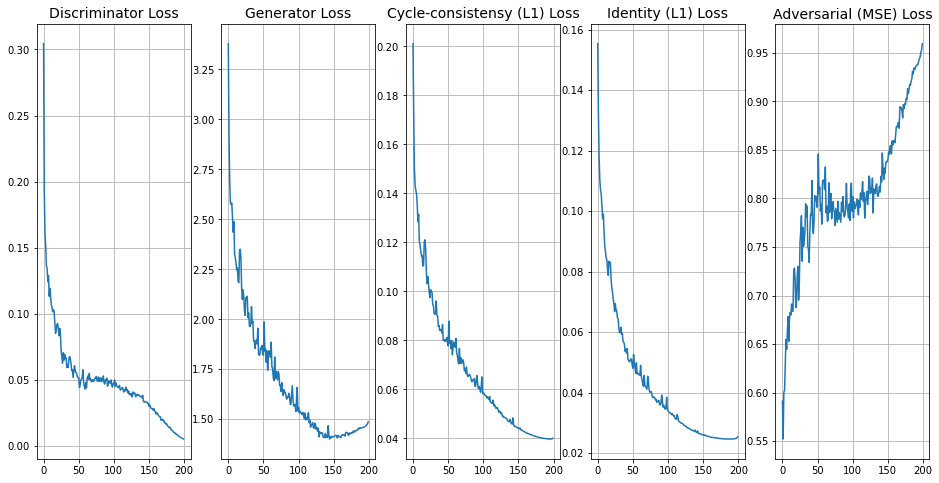

In [39]:
train(
    generator_a, generator_b,
    discriminator_a, discriminator_b,
    train_dataloader, val_dataloader,
    criterion_gan, criterion_cycle, criterion_identity,
    LAMBDA_CYCLE, LAMBDA_IDENTITY,
    optimizer_g, optimizer_d_a, optimizer_d_b,
    lr_scheduler_g, lr_scheduler_d_a, lr_scheduler_d_b,
    buffer_a, buffer_b,
    EPOCH, NUM_EPOCHS,
    SAMPLE_INTERVAL, CHECKPOINT_INTERVAL,
    device=device
)

Результаты после 1 эпохи (здесь и далее первые две строки — оригинальные маски сегментации, вторые две — оригинальные фасады, следующие две — фасады, сгенерированные по оригинальным маскам, в конце — маски, сгенерированные по оригинальным фасадам):

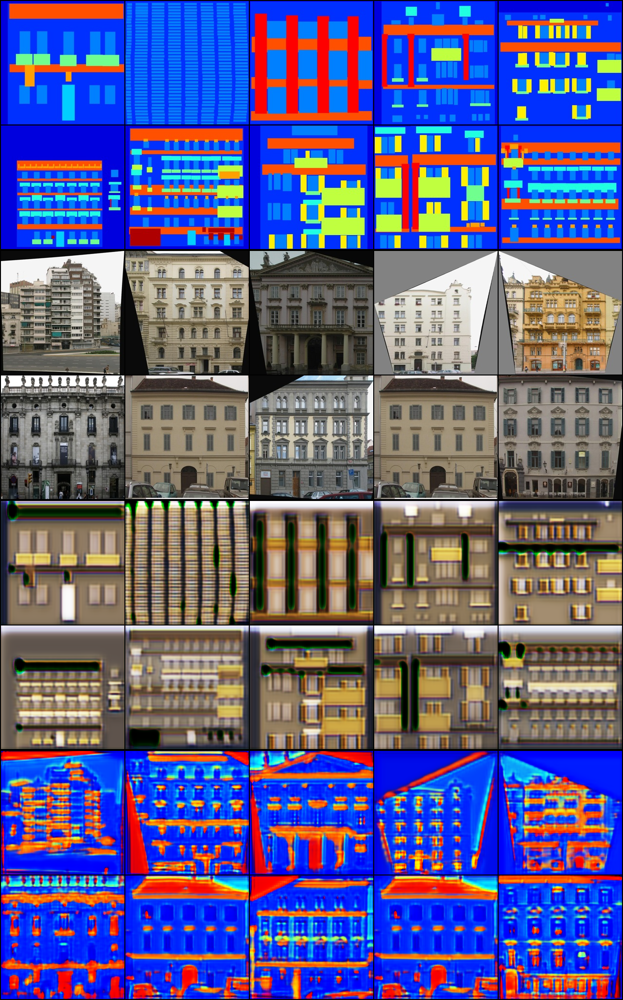

In [40]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '0.png'}"))

Результаты после 50 эпох:

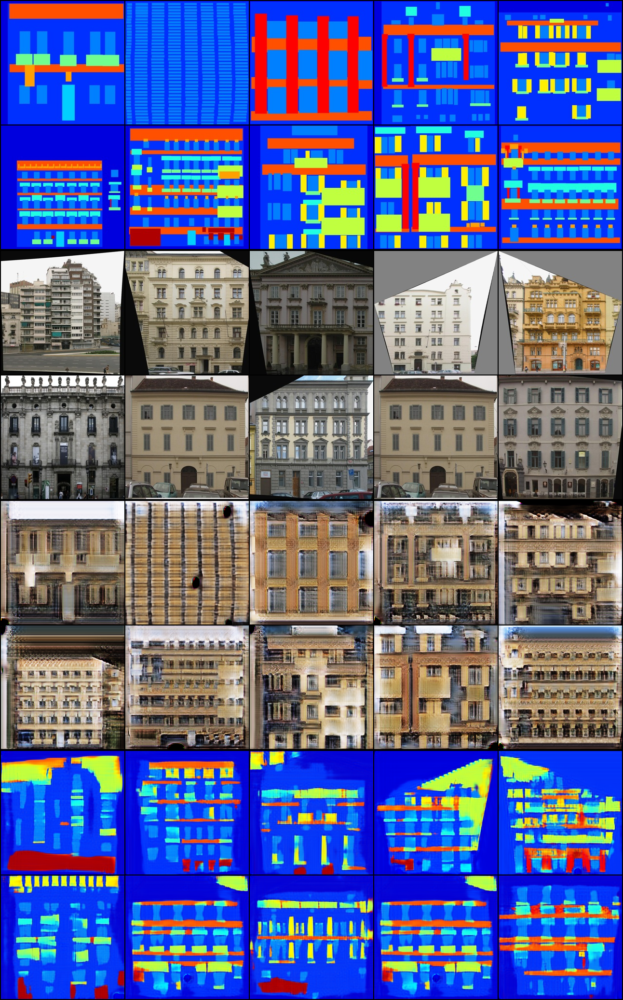

In [41]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '49.png'}"))

Результаты после 100 эпох:

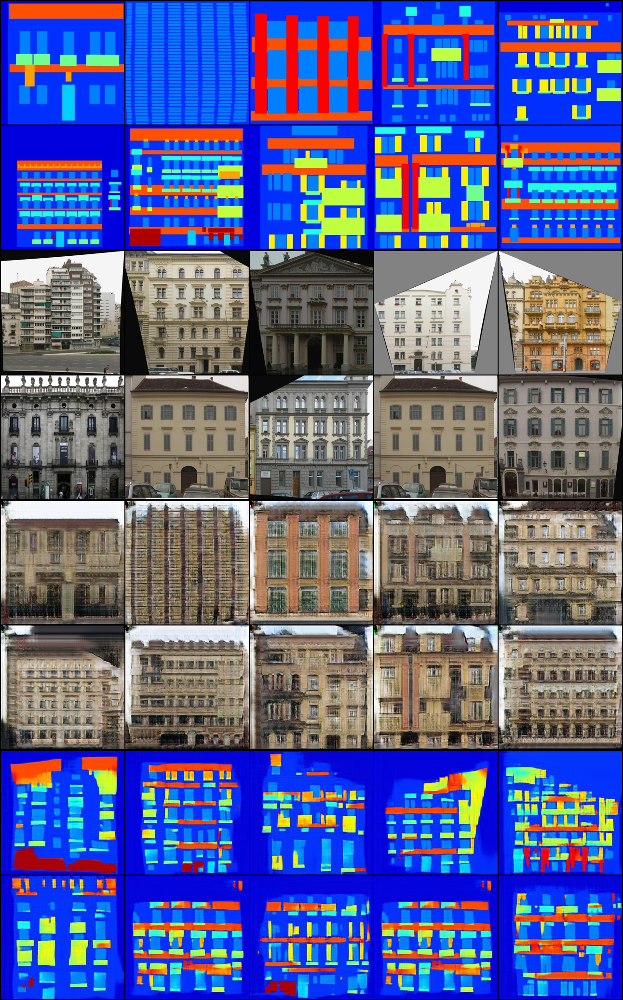

In [42]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '99.png'}"))

Результаты после 150 эпох:

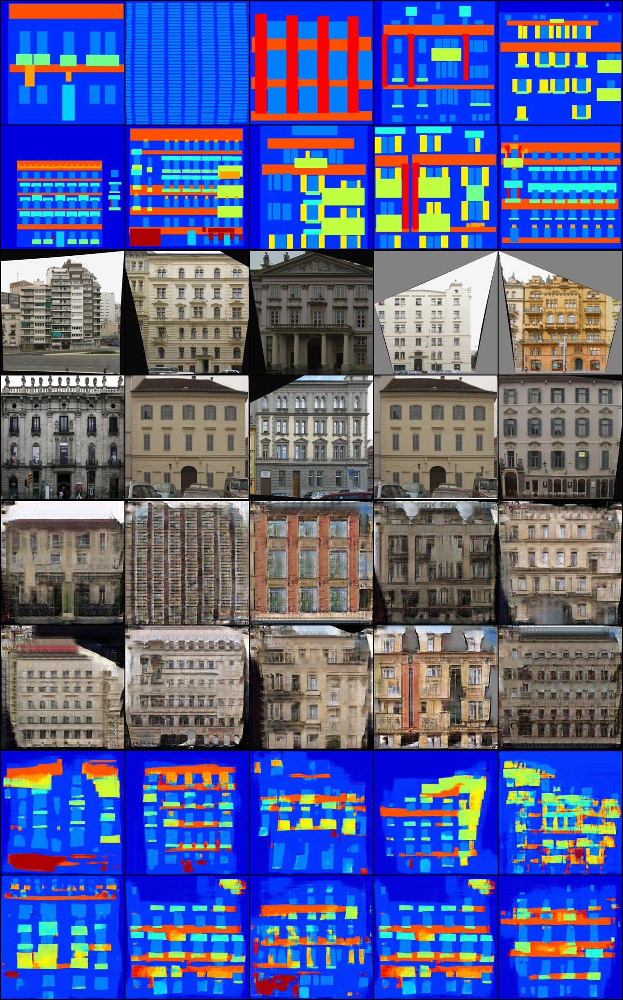

In [43]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '149.png'}"))

Результаты после 200 эпох:

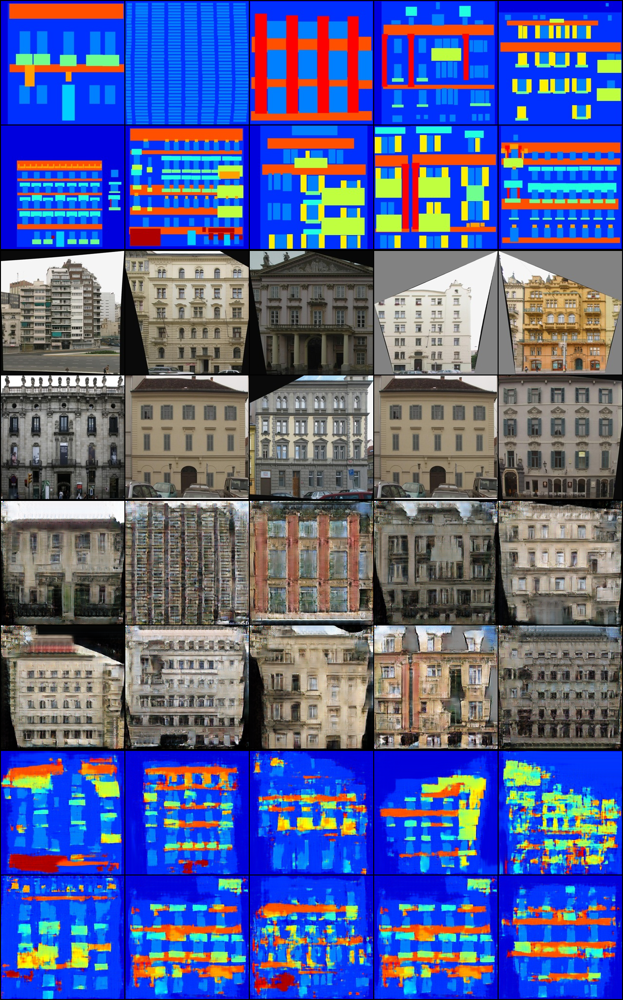

In [44]:
display(Image.open(f"{SAMPLED_IMAGES_PATH / '199.png'}"))